# about

evalutions of pseudobulk rna-seq samples

In [1]:
# data quality
only_include_metastases = True
gene_sparsity_ceiling = 0.5
# pseudobulk generation
n_cells_per_cell_type = 10
malignant_from_one_sample = True

# imports

In [2]:
import numpy as np
import pandas as pd

In [3]:
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io

# plotly.io.renderers.default = "jupyterlab+png"

In [4]:
import helpers

In [5]:
rng = np.random.default_rng(seed=0)

# loading data

In [6]:
%%time
bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg19_scaled_estimate()
# bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg19_normalized_counts_dereks_file()

CPU times: user 11.1 s, sys: 1.66 s, total: 12.7 s
Wall time: 28.3 s


In [7]:
bulk_tcga_skcm

sample_id,TCGA-3N-A9WB-06A-11R-A38C-07,TCGA-3N-A9WC-06A-11R-A38C-07,TCGA-3N-A9WD-06A-11R-A38C-07,TCGA-BF-A1PU-01A-11R-A18S-07,TCGA-BF-A1PV-01A-11R-A18U-07,TCGA-BF-A1PX-01A-12R-A18T-07,TCGA-BF-A1PZ-01A-11R-A18S-07,TCGA-BF-A1Q0-01A-21R-A18S-07,TCGA-BF-A3DJ-01A-11R-A20F-07,TCGA-BF-A3DL-01A-11R-A20F-07,...,TCGA-XV-AB01-06A-12R-A40A-07,TCGA-YD-A89C-06A-11R-A37K-07,TCGA-YD-A9TA-06A-11R-A39D-07,TCGA-YD-A9TB-06A-12R-A40A-07,TCGA-YG-AA3N-01A-11R-A38C-07,TCGA-YG-AA3O-06A-11R-A38C-07,TCGA-YG-AA3P-06A-11R-A38C-07,TCGA-Z2-A8RT-06A-11R-A37K-07,TCGA-Z2-AA3S-06A-11R-A39D-07,TCGA-Z2-AA3V-06A-11R-A39D-07
gene_symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,1.557260e-05,9.770979e-06,9.867653e-06,8.214494e-06,1.319182e-05,0.000011,2.007678e-05,1.600174e-05,1.162966e-05,1.341190e-05,...,1.225520e-05,7.024648e-06,4.711307e-06,1.420643e-05,8.895070e-06,9.687238e-06,1.050934e-06,1.546427e-05,1.734078e-05,2.151290e-05
A1CF,0.000000e+00,0.000000e+00,1.618365e-08,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,6.341529e-08,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.491286e-08,0.000000e+00,0.000000e+00
A2BP1,0.000000e+00,0.000000e+00,7.355062e-08,2.535232e-08,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,7.149177e-09,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.630355e-09,1.622909e-08,1.028863e-06,0.000000e+00,6.274466e-09,8.150594e-09
A2LD1,1.215530e-05,1.007630e-05,2.913834e-06,8.091553e-06,4.023093e-06,0.000006,4.097277e-06,3.721209e-06,5.424464e-06,3.828798e-06,...,1.582717e-06,4.745975e-06,2.434800e-06,9.501916e-06,3.484441e-06,4.954726e-06,1.895828e-06,1.980472e-06,9.025434e-06,1.570295e-06
A2M,7.898068e-05,4.824242e-03,4.009156e-04,1.988917e-04,6.568233e-05,0.000866,1.008798e-04,2.122453e-04,1.082367e-02,1.677088e-04,...,3.109038e-04,5.432744e-04,4.078196e-04,8.717802e-04,2.251480e-04,9.524274e-04,1.826842e-04,6.155309e-04,1.256629e-04,7.927380e-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYX,4.357639e-05,1.539616e-04,7.764624e-05,2.026416e-04,2.610161e-04,0.000148,1.239069e-04,4.407042e-04,1.274164e-04,2.085949e-04,...,2.773654e-04,1.748523e-04,1.755739e-04,1.399126e-04,3.213358e-04,1.277219e-04,6.092688e-05,1.117664e-04,9.318113e-05,2.970830e-04
ZZEF1,3.959755e-06,7.324083e-06,4.961625e-06,1.249919e-05,1.092226e-05,0.000008,1.195551e-05,9.538079e-06,1.064299e-05,7.760680e-06,...,6.364188e-06,5.525628e-06,1.240367e-05,9.237133e-06,1.359631e-05,2.181535e-05,8.731424e-06,1.592902e-05,1.382386e-05,6.305414e-06
ZZZ3,1.620152e-05,2.734027e-05,1.091091e-05,6.605331e-06,4.731625e-05,0.000009,1.608780e-05,2.038022e-05,2.351191e-05,5.271489e-06,...,3.188710e-06,1.454040e-05,2.546843e-05,1.947630e-05,2.197529e-05,2.183025e-05,1.750435e-05,1.079364e-05,3.497588e-05,1.693527e-06


In [ ]:

    x=np.random.randint(7, size=100),
    bingroup=1))

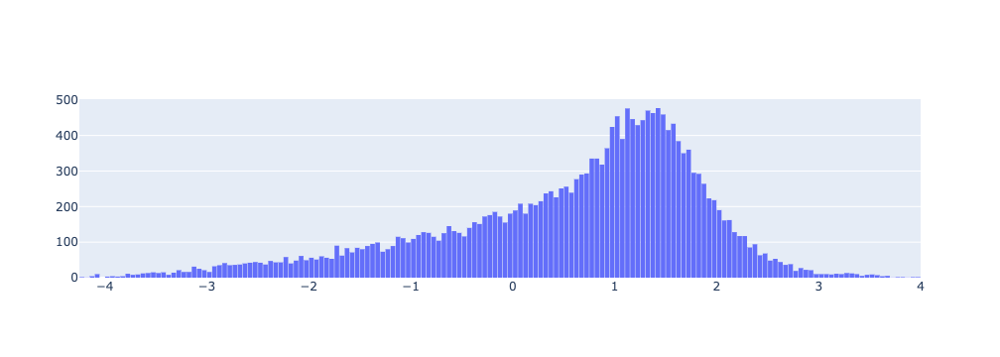

In [19]:
per_million = lambda x: x * 1e6 / x.sum()

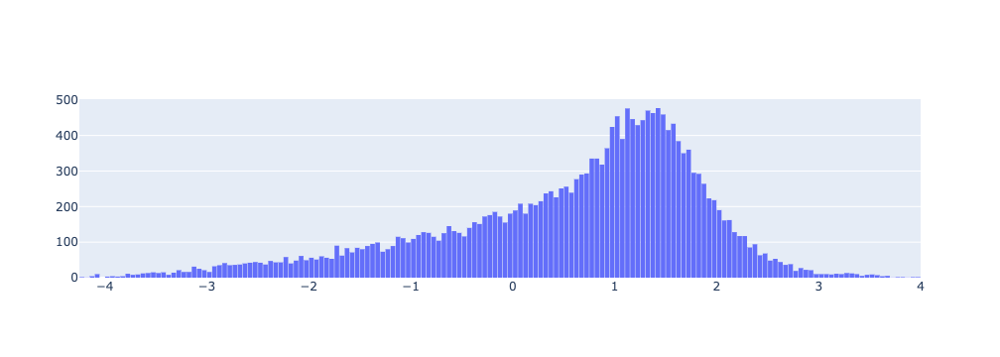

In [22]:
custom_bins_args = dict(
    # start="1969-11-15",
    # end="1972-03-31",
    # size="M18"
)

values = np.log10(per_million(bulk_tcga_skcm.sum(axis=1)))

fig = go.Figure(go.Histogram(x=values, autobinx=False, xbins=custom_bins_args))
fig.update_layout(bargap=0.1)

fig.show()

In [7]:
%%time
fractions_tcga_skcm = helpers.datasets.load_tcga_skcm_fractions_from_csx()

CPU times: user 9.09 ms, sys: 3.65 ms, total: 12.7 ms
Wall time: 51 ms


In [8]:
%%time
try:
    sc_jerby_arnon = (
        pd.read_feather("/tmp/sc_jerby_arnon.feather").set_index("gene_symbol").rename_axis(columns="single_cell_id")
    )
    sc_metadata_jerby_arnon = pd.read_feather("/tmp/sc_metadata_jerby_arnon.feather").set_index("single_cell_id", drop=False)
    print("read from feather")
except:
    sc_jerby_arnon, sc_metadata_jerby_arnon = helpers.datasets.load_jerby_arnon()
    sc_jerby_arnon.reset_index().to_feather("/tmp/sc_jerby_arnon.feather")
    sc_metadata_jerby_arnon.reset_index(drop=True).to_feather("/tmp/sc_metadata_jerby_arnon.feather")
    print("saved to feather")

read from feather
CPU times: user 2.06 s, sys: 2.01 s, total: 4.07 s
Wall time: 1.91 s


In [9]:
# determine gene exclusions

exclusions_genes = pd.DataFrame(index=bulk_tcga_skcm.index.union(sc_jerby_arnon.index))

## sparsity in tcga
genes_sparse_tcga_skcm = bulk_tcga_skcm[(bulk_tcga_skcm == 0).mean(axis=1) > gene_sparsity_ceiling].index
exclusions_genes["sparse_in_tcga_skcm"] = exclusions_genes.index.map(lambda g: g in genes_sparse_tcga_skcm)

## genes not in both cohorts
genes_in_both = bulk_tcga_skcm.index.intersection(sc_jerby_arnon.index)
exclusions_genes["not_in_both_cohorts"] = exclusions_genes.index.map(lambda gene_name: gene_name not in genes_in_both)

good_genes = exclusions_genes.loc[~exclusions_genes.any(axis=1)].index

https://console.cloud.google.com/bigquery?authuser=1&project=keen-dispatch-316219

In [10]:
# determine tcga sample exclusions

exclusions_tcga_samples = pd.DataFrame(index=bulk_tcga_skcm.columns)

## limit to metastases

if only_include_metastases:
    query_text = """
        SELECT aliquot_barcode
        FROM `keen-dispatch-316219.gdc_tcga_skcm_subset.aliquot2caseIDmap_current`
        WHERE sample_type_name = 'Metastatic'
    """
    metastatic_aliquot_barcodes = pd.read_gbq(query_text)["aliquot_barcode"].values
    exclusions_tcga_samples["is_not_metastatic"] = exclusions_tcga_samples.index.map(
        lambda sample: sample not in metastatic_aliquot_barcodes
    )

good_tcga_samples = exclusions_tcga_samples.loc[~exclusions_tcga_samples.any(axis=1)].index

In [11]:
# apply exclusions

print("before exclusions:", [df.shape for df in (sc_jerby_arnon, bulk_tcga_skcm, fractions_tcga_skcm)])
sc_jerby_arnon = sc_jerby_arnon.loc[good_genes]
bulk_tcga_skcm = bulk_tcga_skcm.loc[good_genes][good_tcga_samples]
fractions_tcga_skcm = fractions_tcga_skcm.loc[good_tcga_samples]
print("after exclusions:", [df.shape for df in (sc_jerby_arnon, bulk_tcga_skcm, fractions_tcga_skcm)])

before exclusions: [(23686, 7186), (20501, 473), (473, 9)]
after exclusions: [(16063, 7186), (16063, 368), (368, 9)]


In [12]:
# convert to TPM

bulk_tcga_skcm *= 1_000_000 / bulk_tcga_skcm.sum()
sc_jerby_arnon *= 1_000_000 / sc_jerby_arnon.sum()

In [13]:
# compute pseudobulks and their cell type GEPs

bulk_pseudo, bulk_pseudo_cell_type_geps = helpers.creating_mixtures.make_mixtures(
    sc_jerby_arnon,
    sc_metadata_jerby_arnon,
    fractions_tcga_skcm.rename(index=lambda sample: f"pseudo_like_{sample}"),
    n_cells_per_gep=n_cells_per_cell_type,
    normalization_factor=1_000_000,
    malignant_from_one_sample=malignant_from_one_sample,
    rng=rng,
)

# figures

## mean dists

In [14]:
bulk_all = pd.concat({"tcga skcm": bulk_tcga_skcm, "pseudobulk": bulk_pseudo}, axis=1)
dfg = bulk_all.stack().groupby("gene_symbol")
log_means = np.log10(dfg.aggregate("mean") + 1e-2)
log_stddevs = np.log10(dfg.aggregate("std") + 1e-2)

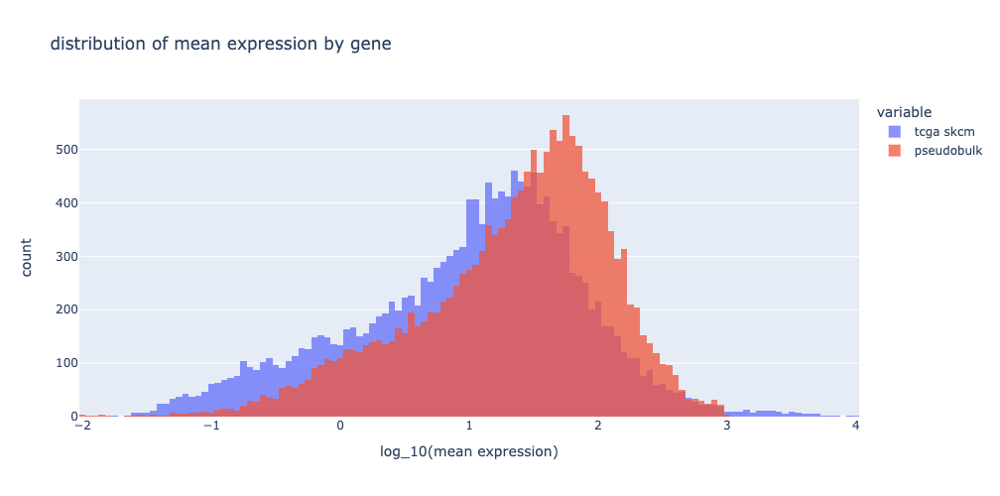

In [15]:
# df = pd.DataFrame({"tcga skcm": aggregate(bulk_tcga_skcm), "pseudobulks": aggregate(bulk_pseudo)})
title = "distribution of mean expression by gene"
x_axis_title = "log_10(mean expression)"
fig = px.histogram(log_means, title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.75)
fig.update_xaxes(title=x_axis_title)

In [16]:
fig.write_image("figures/mean_dist.png", width=800, height=500, scale=2)

### looking into very high expressed TCGA SKCM genes...

In [17]:
log_means.nlargest(10, columns=["tcga skcm"])

,tcga skcm,pseudobulk
gene_symbol,,
GAPDH,4.012246,3.009095
RPLP1,3.989264,2.997479
FTL,3.957734,2.970934
RPS18,3.927969,2.990632
B2M,3.841852,2.906620
RPL37A,3.830827,2.916458
TPT1,3.823056,2.931053
ACTB,3.816013,2.958090
CD74,3.739689,2.432555


## stddev dists

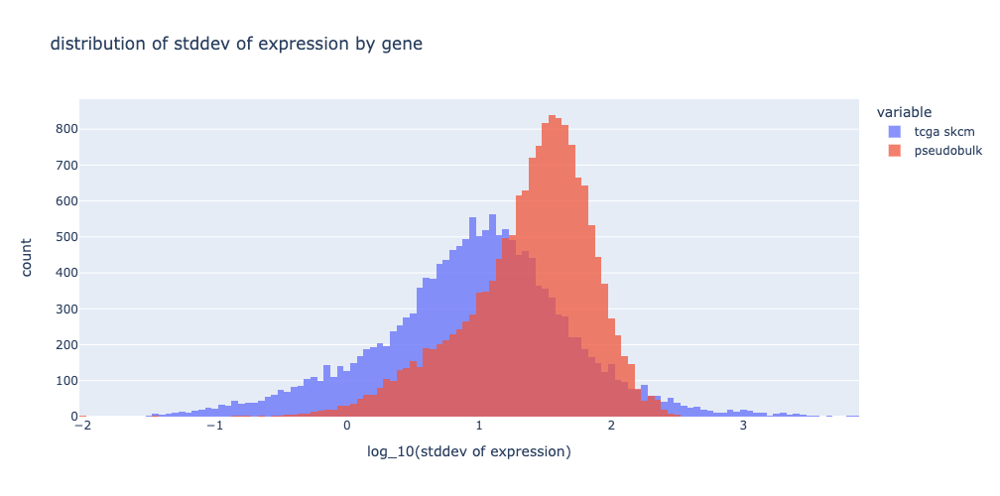

In [18]:
# df = pd.DataFrame({"tcga skcm": aggregate(bulk_tcga_skcm), "pseudobulks": aggregate(bulk_pseudo)})
title = "distribution of stddev of expression by gene"
x_axis_title = "log_10(stddev of expression)"
fig = px.histogram(log_stddevs, title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.75)
fig.update_xaxes(title=x_axis_title)

In [19]:
fig.write_image("figures/stddev_dist.png", width=800, height=500, scale=2)

## mean jointdist scatter

/opt/conda/envs/deconv/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning:

divide by zero encountered in log10

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1652: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1687: RuntimeWarning:

invalid value encountered in subtract



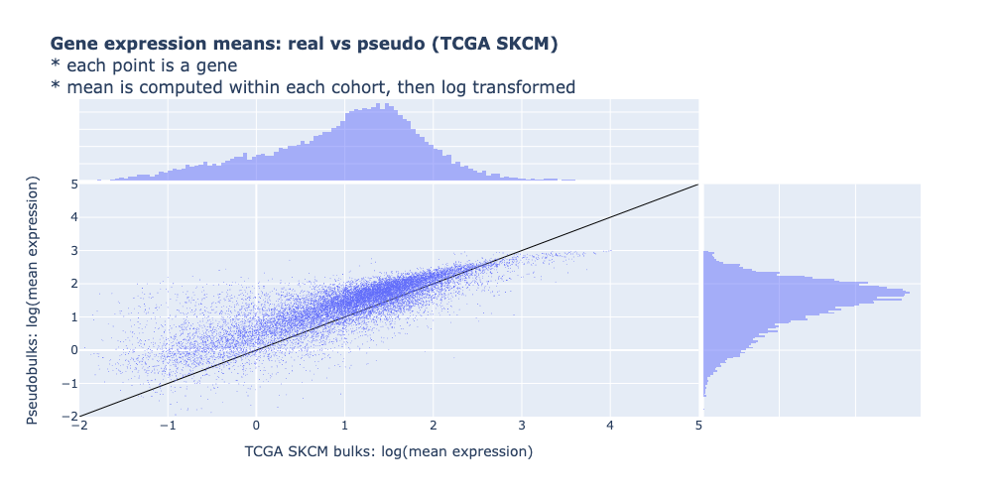

In [20]:
title = (
    "<b>Gene expression means: real vs pseudo (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* mean is computed within each cohort, then log transformed"
)
label_real, label_pseudo = "TCGA SKCM bulks", "pseudobulks"
axis_range = [-2, 5]

df = pd.DataFrame(
    {
        label_real: np.log10(bulk_tcga_skcm.mean(axis=1)),
        f"{label_real} sparsity": (bulk_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(bulk_pseudo.mean(axis=1)),
        f"{label_pseudo} sparsity": (bulk_pseudo == 0).mean(axis=1),
    },
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
    trendline="ols",
)
fig.add_trace(
    go.Scatter(
        x=axis_range,
        y=axis_range,
        marker=dict(color="black"),
        line=dict(width=1),
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM bulks: log(mean expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.update_yaxes(
    title="Pseudobulks: log(mean expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
# fig.show(height=800)

In [21]:
fig.write_image("figures/mean_jointdist_scatter.png", width=800, height=700, scale=2)

## stddev jointdist scatter

/opt/conda/envs/deconv/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning:

divide by zero encountered in log10

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1652: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1687: RuntimeWarning:

invalid value encountered in subtract



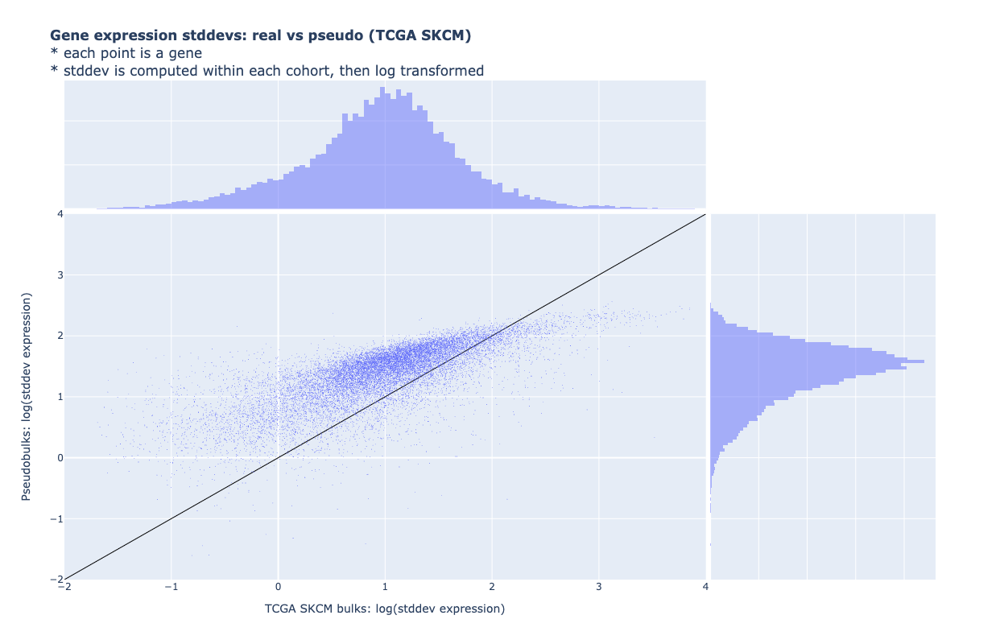

In [22]:
title = (
    "<b>Gene expression stddevs: real vs pseudo (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* stddev is computed within each cohort, then log transformed"
)
label_real, label_pseudo = "TCGA SKCM bulks", "pseudobulks"
axis_range = [-2, 4]

df = pd.DataFrame(
    {
        label_real: np.log10(bulk_tcga_skcm.std(axis=1)),
        f"{label_real} sparsity": (bulk_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(bulk_pseudo.std(axis=1)),
        f"{label_pseudo} sparsity": (bulk_pseudo == 0).mean(axis=1),
    },
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
    trendline="ols",
)
fig.add_trace(
    go.Scatter(
        x=axis_range,
        y=axis_range,
        marker=dict(color="black"),
        line=dict(width=1),
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM bulks: log(stddev expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.update_yaxes(
    title="Pseudobulks: log(stddev expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.show(height=800)

In [23]:
fig.write_image("figures/stddev_jointdist_scatter.png", width=800, height=700, scale=2)

## PCA

In [24]:
all_bulks = pd.concat(
    {"tcga skcm": bulk_tcga_skcm, "pseudobulks": bulk_pseudo}, axis=1, names=["sample_origin", helpers.columns.SAMPLE_ID]
).T

In [25]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(all_bulks)
all_bulks.values[:] = scaler.transform(all_bulks)

all_bulks.iloc[:, :5].agg(["mean", "std"])

gene_symbol,A1BG,A2M,A2ML1,A4GALT,A4GNT
mean,-9.267949e-16,8.109455e-16,0.00000,-7.723291e-17,9.654113e-18
std,1.000680e+00,1.000680e+00,1.00068,1.000680e+00,1.000680e+00


In [26]:
from sklearn.decomposition import PCA

n_components = 10

pca = PCA(n_components=n_components)
pca.fit(all_bulks)
pca_gene_eigenvectors = (
    pd.DataFrame(pca.components_, columns=all_bulks.columns, index=["PC " + str(i + 1) for i in range(n_components)])
    .rename_axis(index="PCs")
    .T
)
pca_plot_axis_labels = {str(i): f"PC {i+1}<br>({var:.1f}%)" for i, var in enumerate(pca.explained_variance_ratio_ * 100)}

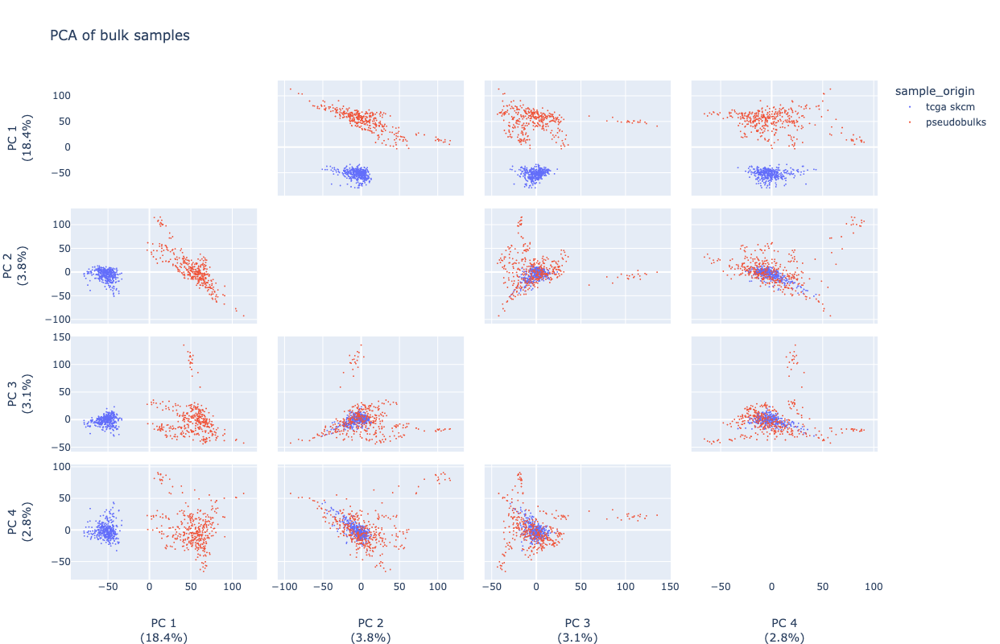

In [27]:
pca_coefficients_all_bulks = pd.DataFrame(pca.transform(all_bulks), index=all_bulks.index).reset_index()

fig = px.scatter_matrix(
    pca_coefficients_all_bulks,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color="sample_origin",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of bulk samples",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image("figures/pca_4_samples.png", width=800, height=700, scale=2)

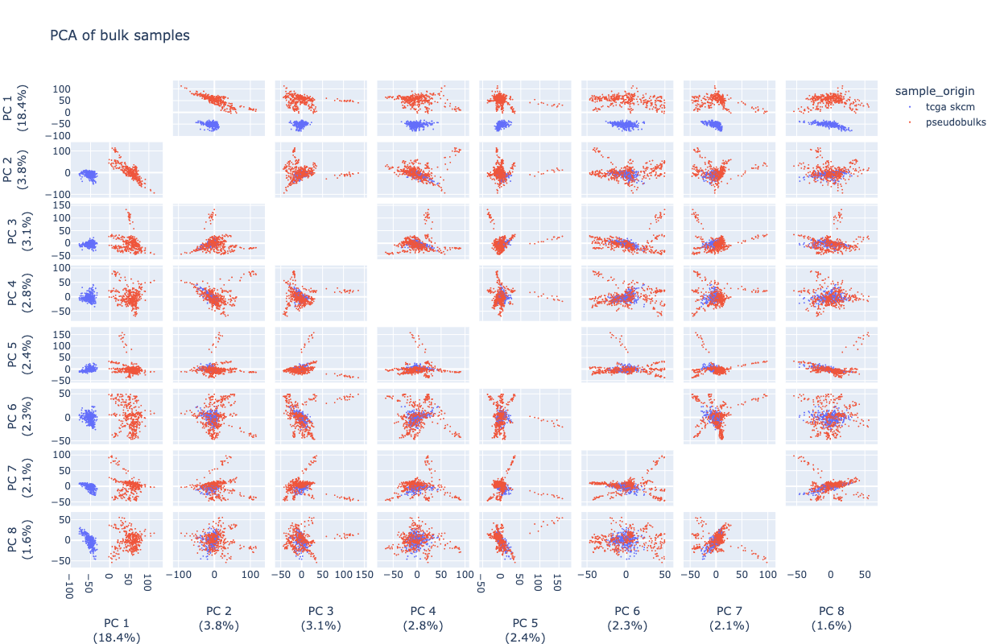

In [28]:
fig = px.scatter_matrix(
    pca_coefficients_all_bulks,
    labels=pca_plot_axis_labels,
    dimensions=range(8),
    color="sample_origin",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of bulk samples",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image("figures/pca_8_samples.png", width=800, height=700, scale=2)

### applied to pseudobulk cell type GEPs

In [29]:
pseudo_cell_type_geps = pd.concat(
    bulk_pseudo_cell_type_geps, axis=1, names=[helpers.columns.SAMPLE_ID, helpers.columns.CELL_TYPE]
).T
pseudo_cell_type_geps.values[:] = scaler.transform(pseudo_cell_type_geps)
pseudo_cell_type_geps.iloc[:, :5].agg(["mean", "std"])

gene_symbol,A1BG,A2M,A2ML1,A4GALT,A4GNT
mean,-0.229346,-0.438804,1.325902,0.933241,0.289086
std,1.028955,0.138283,1.466150,3.449868,2.568036


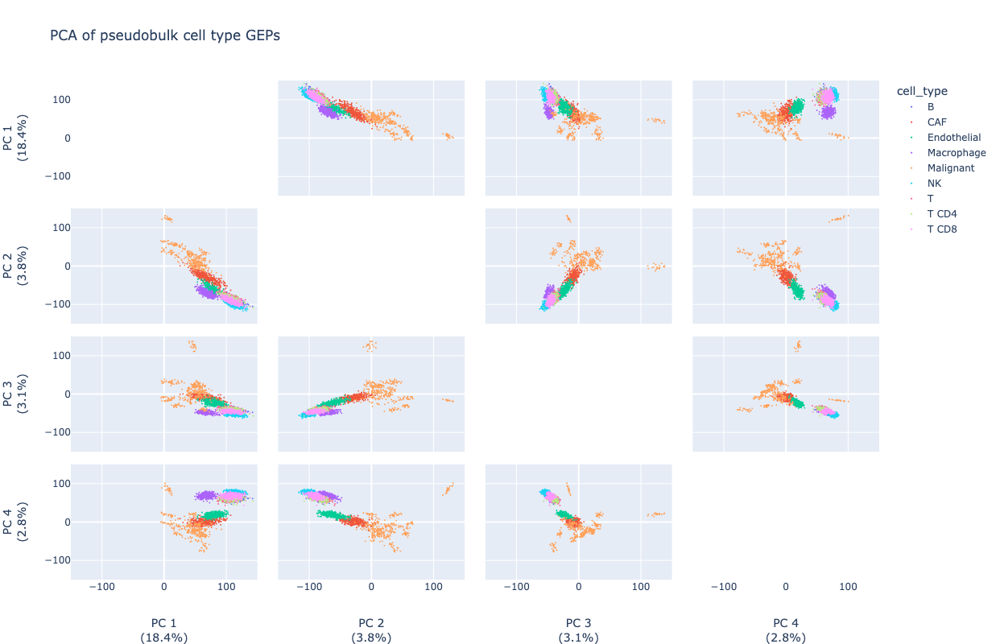

In [30]:
pca_coefficients_pseudo_cell_type_geps = pd.DataFrame(
    pca.transform(pseudo_cell_type_geps), index=pseudo_cell_type_geps.index
).reset_index()

fig = px.scatter_matrix(
    pca_coefficients_pseudo_cell_type_geps,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color=helpers.columns.CELL_TYPE,
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of pseudobulk cell type GEPs",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.show(height=800)
fig.write_image("figures/pca_4_pseudo_cell_type_geps.png", width=800, height=700, scale=2)

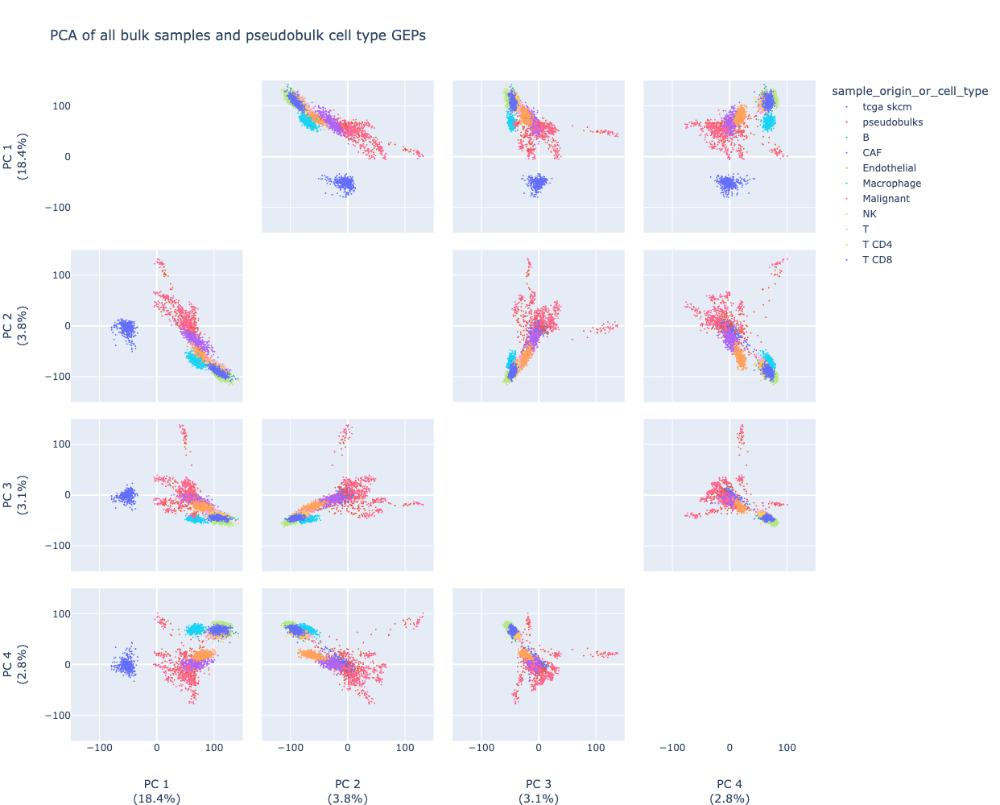

In [31]:
pca_coefficients_bulks_and_geps = pd.concat([pca_coefficients_all_bulks, pca_coefficients_pseudo_cell_type_geps])
pca_coefficients_bulks_and_geps["sample_origin_or_cell_type"] = pca_coefficients_bulks_and_geps["sample_origin"].fillna(
    pca_coefficients_bulks_and_geps["cell_type"]
)

fig = px.scatter_matrix(
    pca_coefficients_bulks_and_geps,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color="sample_origin_or_cell_type",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of all bulk samples and pseudobulk cell type GEPs",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image("figures/pca_4_bulks_and_geps.png", width=800, height=700, scale=2)
fig.show(height=1000, width=800)

### first PC

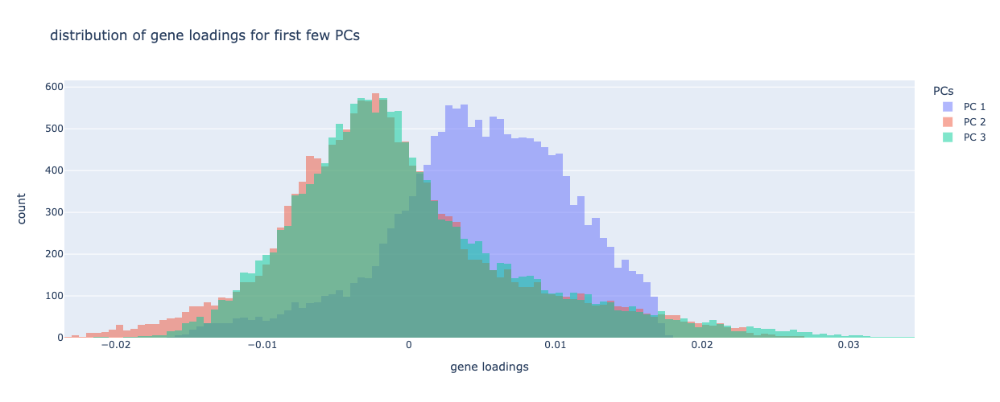

In [32]:
title = "distribution of gene loadings for first few PCs"
fig = px.histogram(pca_gene_eigenvectors.iloc[:, :3], title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.5)
fig.update_xaxes(title="gene loadings")

In [33]:
gene_features = pca_gene_eigenvectors.iloc[:, :3]
gene_features["sparse_rate_bulk_tcga_skcm"] = (bulk_tcga_skcm == 0).mean(axis=1)
gene_features["sparse_rate_sc_jerby_arnon"] = (sc_jerby_arnon == 0).mean(axis=1)
gene_features["mean_bulk_tcga_skcm"] = bulk_tcga_skcm.mean(axis=1)
gene_features["stddev_bulk_tcga_skcm"] = bulk_tcga_skcm.std(axis=1)
gene_features["mean_sc_jerby_arnon"] = sc_jerby_arnon.mean(axis=1)
gene_features["stddev_sc_jerby_arnon"] = sc_jerby_arnon.std(axis=1)

In [34]:
gene_features.corr(
    # method="spearman"
)

PCs,PC 1,PC 2,PC 3,sparse_rate_bulk_tcga_skcm,sparse_rate_sc_jerby_arnon,mean_bulk_tcga_skcm,stddev_bulk_tcga_skcm,mean_sc_jerby_arnon,stddev_sc_jerby_arnon
PCs,,,,,,,,,
PC 1,1.000000,0.108293,0.018816,-0.072193,-0.446821,-0.290392,-0.278535,0.042431,0.162939
PC 2,0.108293,1.000000,-0.003238,-0.031817,-0.046192,0.029324,-0.002459,0.134316,0.191173
PC 3,0.018816,-0.003238,1.000000,-0.084431,-0.016801,-0.006497,0.000578,-0.030587,-0.001651
sparse_rate_bulk_tcga_skcm,-0.072193,-0.031817,-0.084431,1.000000,0.244568,-0.074164,-0.054330,-0.201439,-0.360403
sparse_rate_sc_jerby_arnon,-0.446821,-0.046192,-0.016801,0.244568,1.000000,-0.266854,-0.189164,-0.691016,-0.614836
mean_bulk_tcga_skcm,-0.290392,0.029324,-0.006497,-0.074164,-0.266854,1.000000,0.885758,0.642255,0.394476
stddev_bulk_tcga_skcm,-0.278535,-0.002459,0.000578,-0.054330,-0.189164,0.885758,1.000000,0.500689,0.329137
mean_sc_jerby_arnon,0.042431,0.134316,-0.030587,-0.201439,-0.691016,0.642255,0.500689,1.000000,0.816679
stddev_sc_jerby_arnon,0.162939,0.191173,-0.001651,-0.360403,-0.614836,0.394476,0.329137,0.816679,1.000000


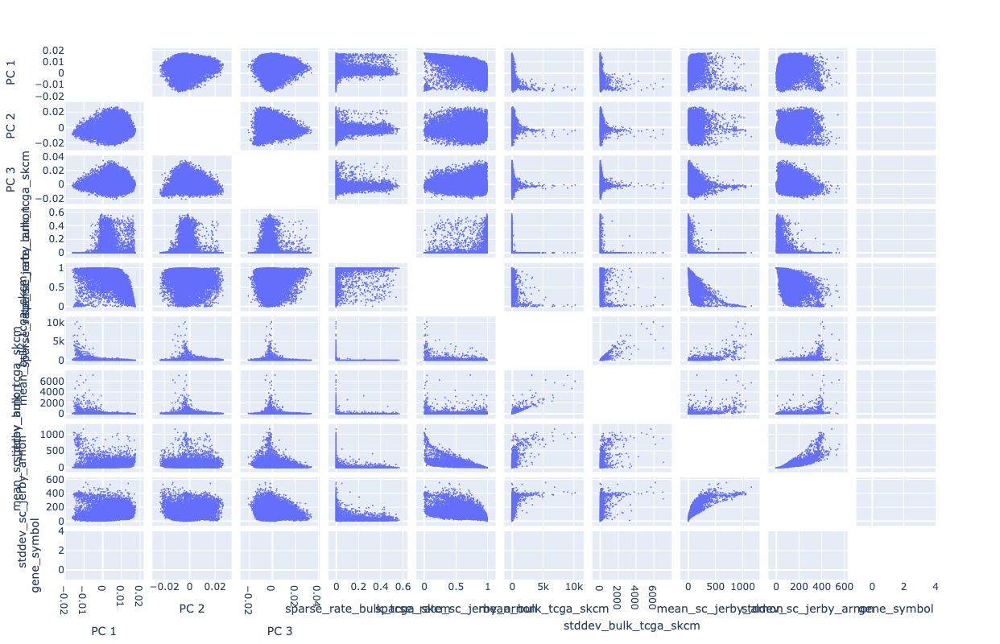

In [35]:
fig = px.scatter_matrix(gene_features, hover_name=gene_features.index)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.write_image("figures/gene_features_scatter_matrix.png", width=800, height=700, scale=2)

In [36]:
gene_features.sort_values(by="PC 1", ascending=False)

PCs,PC 1,PC 2,PC 3,sparse_rate_bulk_tcga_skcm,sparse_rate_sc_jerby_arnon,mean_bulk_tcga_skcm,stddev_bulk_tcga_skcm,mean_sc_jerby_arnon,stddev_sc_jerby_arnon
gene_symbol,,,,,,,,,
ODF2L,0.017649,-0.002622,-0.000868,0.000000,0.014194,11.605792,8.055480,405.643794,212.186048
ASTN2,0.017616,-0.001294,-0.000095,0.000000,0.010854,14.649069,23.298483,539.762641,268.156559
LOC646214,0.017553,-0.004738,0.001878,0.000000,0.011272,1.240146,0.768443,361.185443,202.390251
KCNQ1OT1,0.017539,-0.004920,0.000037,0.000000,0.001113,0.190905,0.241175,293.179476,167.955114
SHISA9,0.017526,-0.003864,-0.000175,0.331522,0.014055,0.382022,2.686233,421.383464,226.895500
...,...,...,...,...,...,...,...,...,...
EIF3CL,-0.015617,-0.005439,-0.000098,0.000000,0.771639,454.716117,178.150275,12.092806,74.332519
PABPN1,-0.015685,-0.007806,-0.002431,0.000000,0.946563,100.721048,30.185098,8.217288,46.785392
PRKACA,-0.015742,-0.008297,-0.002753,0.000000,0.890481,99.610691,30.743597,10.515992,45.266584


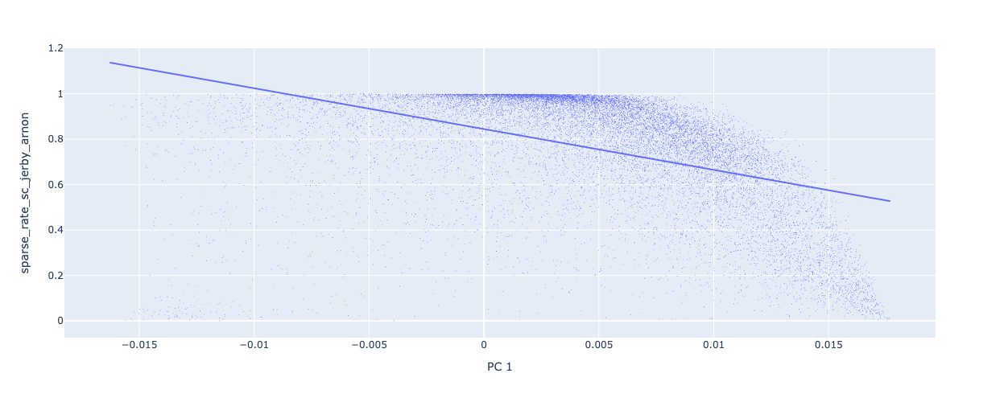

In [37]:
fig = px.scatter(
    gene_features,
    x="PC 1",
    y="sparse_rate_sc_jerby_arnon",
    trendline="ols",
)
fig.update_traces(marker=dict(size=1))

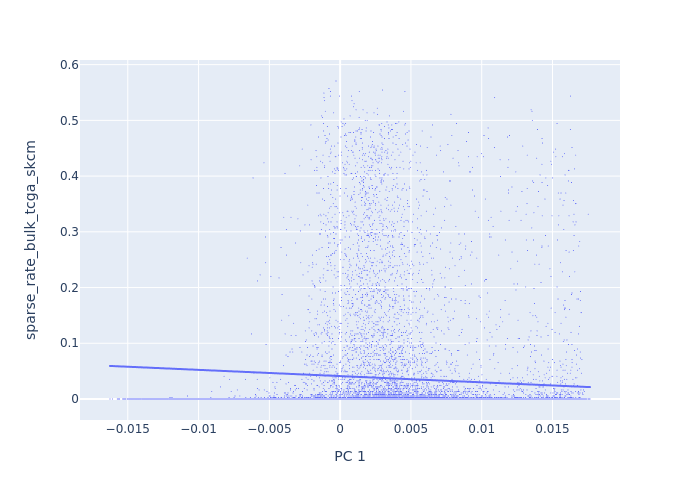

In [38]:
fig = px.scatter(
    gene_features,
    x="PC 1",
    y="sparse_rate_bulk_tcga_skcm",
    trendline="ols",
)
fig.update_traces(marker=dict(size=1))

In [39]:
pca_gene_eigenvectors["PC 1"].nlargest(10)

gene_symbol
ODF2L        0.017649
ASTN2        0.017616
LOC646214    0.017553
KCNQ1OT1     0.017539
SHISA9       0.017526
LPP          0.017443
SPC25        0.017382
OPHN1        0.017364
XIAP         0.017358
GOSR1        0.017333
Name: PC 1, dtype: float64

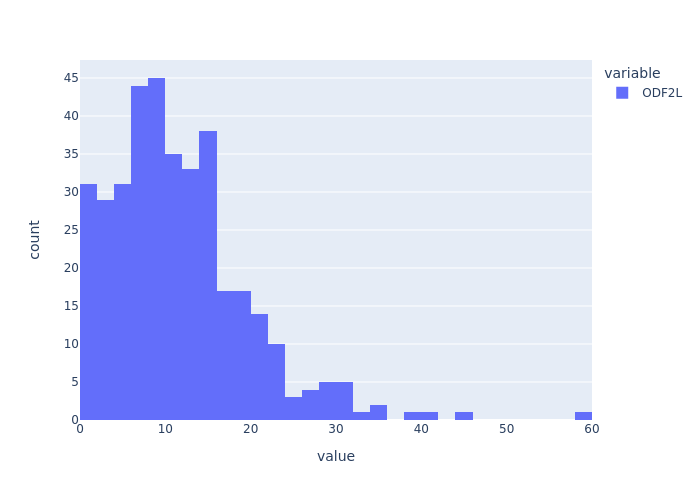

In [40]:
px.histogram(bulk_tcga_skcm.loc["ODF2L"])

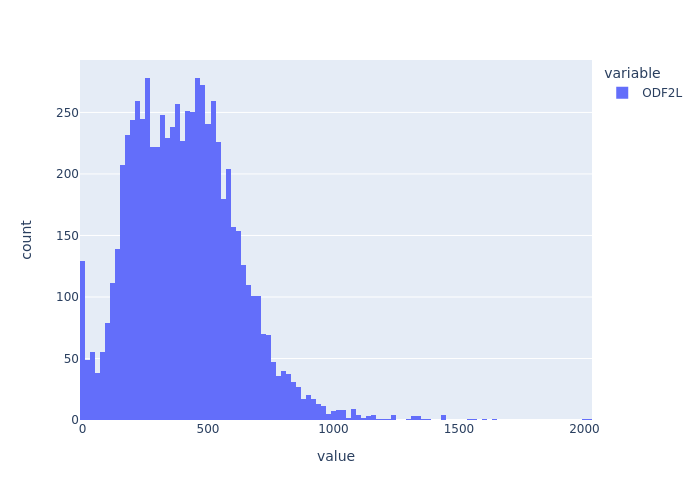

In [41]:
px.histogram(sc_jerby_arnon.loc["ODF2L"])